In [1]:
import os
import itertools
import numpy as np
import pandas as pd
import seaborn as sn
from PIL import Image
import scipy.ndimage as ndi
from sklearn.svm import LinearSVC
import matplotlib.pyplot as plt
import matplotlib.image as mpimg
from sklearn.decomposition import PCA
from skimage import io, transform, exposure, filters, feature, color, data
from sklearn.model_selection import train_test_split
from sklearn.metrics import confusion_matrix
from sklearn.model_selection import train_test_split
from sklearn.preprocessing import StandardScaler
from sklearn.metrics import accuracy_score
import cv2
import tensorflow as tf
from tensorflow.keras.preprocessing.image import ImageDataGenerator
from tensorflow.keras.models import Sequential
from tensorflow.keras.layers import *
from tensorflow.keras.optimizers import *

# US License Plate Classification 

### The link to dataset 

https://www.kaggle.com/datasets/gpiosenka/us-license-plates-image-classification

### Basic info about your dataset such as: number of images, number of classes (if it's a classification problem), type of images (color or grayscale, photo or hand-drawn etc.), size of images, size of classes, etc
    
    This dataset contains a vast collection of distinct and unique license plate from each 50 states of the United State of America, but also contains plates from local islands surronding American, that fall under American territory. The total amounts of plates per states file ranges from 130-150, therefore containing sufficient data to help train our techniques. Will try a few different techniques to see what approach might be best to achieve a classicifation with high accruacy. 
    
    This will be a image classification problem, thankfully the convient property of this dataset is that its contents are preppred nicely and ready for use already and require minial to no editing or "cleaning-up" or the data or images. So that allows so easy manuplication and application of the nessacry techiques required to accomplishes this complex classification problem. 

In [2]:
path = 'Plates/new'
states = os.listdir(path +'/train')
states.remove(".DS_Store")
print(states)

['MISSOURI', 'ALASKA', 'NEW HAMPSHIRE', 'ILLINOIS', 'VIRGINIA', 'CNMI', 'WASHINGTON', 'VERMONT', 'SOUTH DAKOTA', 'AMERICAN SAMOA', 'GEORGIA', 'CONNECTICUT', 'ALABAMA', 'GUAM', 'OKLAHOMA', 'COLORADO', 'OHIO', 'MAINE', 'UTAH', 'SOUTH CAROLINA', 'DELAWARE', 'INDIANA', 'ARKANSAS', 'IOWA', 'NEW JERSEY', 'WISCONSIN', 'MICHIGAN', 'ARIZONA', 'MASSACHUSETTS', 'MONTANA', 'NEW YORK', 'WYOMING', 'PUERTO RICO', 'MINNESOTA', 'WEST VIRGINIA', 'WASHINGTON DC', 'NORTH DAKOTA', 'FLORIDA', 'KENTUCKY', 'U S VIRGIN ISLANDS', 'LOUISIANA', 'MARYLAND', 'TEXAS', 'HAWAI', 'RHODE ISLAND', 'KANSAS', 'PENNSYLVANIA', 'NORTH CAROLINA', 'NEBRASKA', 'TENNESSEE', 'IDAHO', 'OREGON', 'NEVADA', 'CALIFORNIA', 'NEW MEXICO', 'MISSIPPI']


In [3]:
def get_count(set_type, state):
    return len(os.listdir(path + '/' + set_type + "/" + state))

for each_class in states:
    for set_type in ['train', 'test']:
        print("Number of {} samples in {} category {}".format(set_type, each_class, get_count(set_type, each_class)))

Number of train samples in MISSOURI category 149
Number of test samples in MISSOURI category 5
Number of train samples in ALASKA category 149
Number of test samples in ALASKA category 5
Number of train samples in NEW HAMPSHIRE category 158
Number of test samples in NEW HAMPSHIRE category 5
Number of train samples in ILLINOIS category 144
Number of test samples in ILLINOIS category 5
Number of train samples in VIRGINIA category 143
Number of test samples in VIRGINIA category 5
Number of train samples in CNMI category 86
Number of test samples in CNMI category 5
Number of train samples in WASHINGTON category 165
Number of test samples in WASHINGTON category 5
Number of train samples in VERMONT category 150
Number of test samples in VERMONT category 5
Number of train samples in SOUTH DAKOTA category 133
Number of test samples in SOUTH DAKOTA category 5
Number of train samples in AMERICAN SAMOA category 143
Number of test samples in AMERICAN SAMOA category 5
Number of train samples in GEOR

    As you can observe the dataset has ample data to about to train and test on for a Image Classsification problem.
    
    The new plates dataset is a very high quality dataset. All images are originals, no augmented images are present in the dataset. The dataset was carefully constructed so that it does not contain any duplicate images. . All images are size 128 X 224 X 3 in jpg format. All images have been cropped so the the license plate occupies at least 90% of the pixels in any image. This ensures that even fairly simple models will achieve high training, validation and test accuracy.
    
### Heres an example of what the images within this dataset look like

(-0.5, 223.5, 127.5, -0.5)

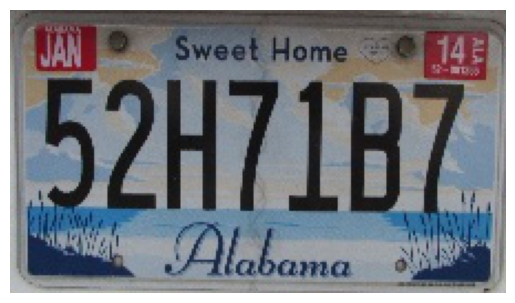

In [4]:
image = io.imread("Plates/new/test/ALABAMA/1.jpg")

plt.imshow(image)
plt.axis('off')

    Knowing the images look like this already we can jump right to applying our techniques. First I want to try using the color histrogram of the licence plates to classify themselves. I beleive this could be a good idea because each state as unique and distinct designs based on their states special colors, birds, places, monuments, etc. So with that in mind I want to take a look at a color historgram of the first few images in each state just to get a feel.

## Color Histrogram graphs

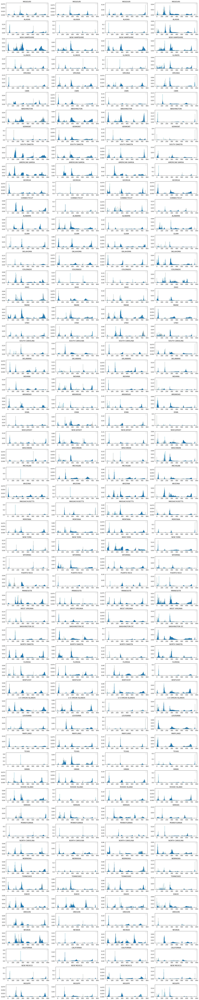

In [9]:
plt.figure(figsize=(20, 100))

num_cols = 2

directory = os.listdir(path + '/train')
directory.remove(".DS_Store")
for i, each in enumerate(directory):
    currentFolder = path + '/train/' + each
    for j, file in enumerate(os.listdir(currentFolder)[:4]):
        fullpath = path + '/train/' + each + "/" + file
        img = mpimg.imread(fullpath)
        h = colorHistogram(img)

        # Calculate the subplot position
        plt.subplot(len(directory), 4, i * 4 + j + 1)

        plt.title(each)
        plt.legend(["Plate 1", "Plate 2", "Plate 3"], loc="best")
        plt.bar(range(len(h)), h)

        # Set the y-axis limits to make the bars more visible
        plt.ylim(0, max(h) * 1.2)
        
plt.tight_layout()
plt.show()

        After a quick glance at these color histrograms we some overlap between the plates in the same states, but overall there is a range for all plates even across different states as well as within the same one. 
        
        Upon doing further reseach on the dataset and how these images were all obtained, I discovered that the dataset includes plates from differnet "eras" within the DMVs eras. Where that means the state changes the offical plates of the state to a new one. But to also further delute the data, it contains custom plates, plates for differnet vechiles like trucks plates, fleet plates, eletric vehicle plates, specialty plates. 
        
        Hence, we can conclude that the color histograms that we saw earlier that had similar histrograms must have been from the same "era" and not customs ones. This will make using collor histrogram alone to classify these license plates with be diffucult and most likely a very low accruacy probability. 
    
    Lets look at all the different license plate and the possible images within the files, to get a more realistic visual of the plates rather than graphs.  

/var/folders/7x/wsh9sz5x5qddc0q_1ty31n9w0000gn/T/ipykernel_51873/3880916068.py:4: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`). Consider using `matplotlib.pyplot.close()`.
  plt.figure(figsize=(20, 30))


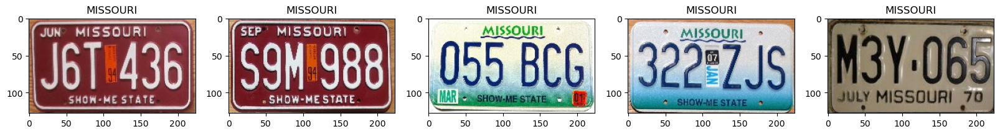

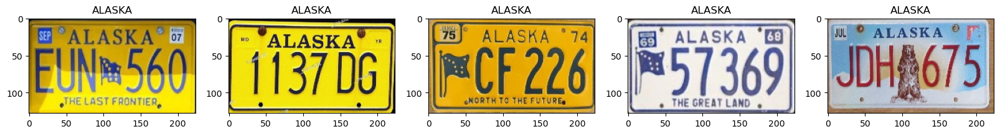

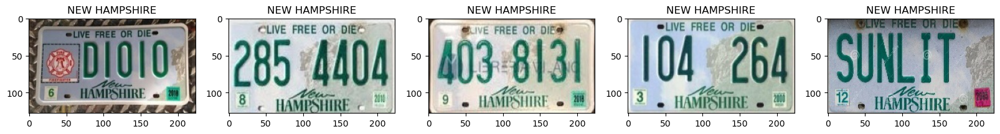

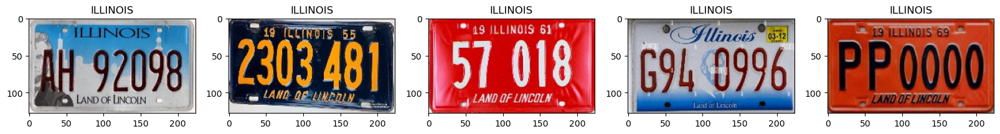

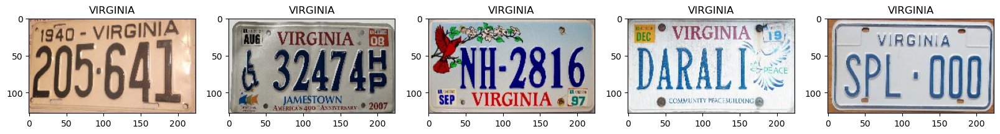

...

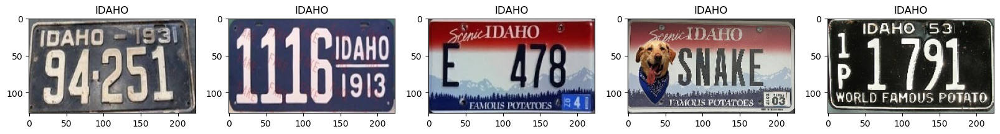

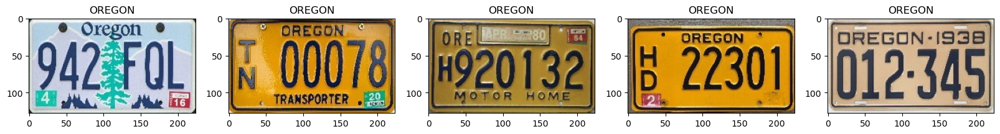

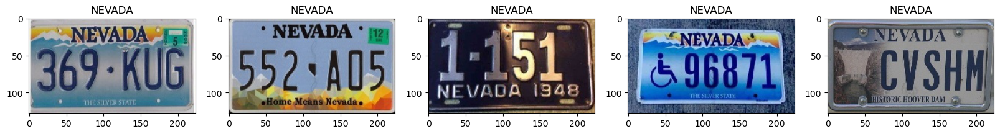

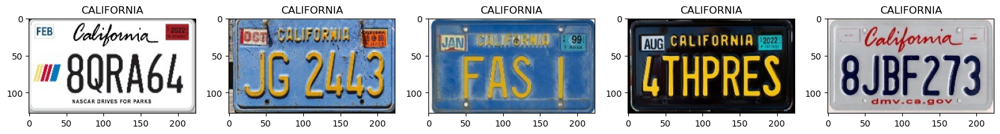

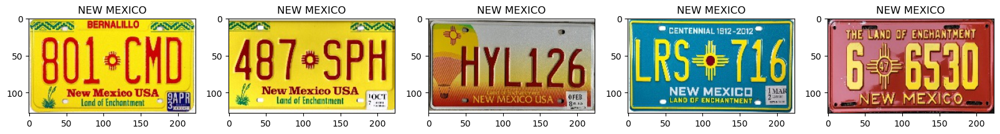

In [10]:
directory=os.listdir(path + '/train')
directory.remove(".DS_Store")
for each in directory:
    plt.figure(figsize=(20, 30))
    currentFolder = path + '/train/' + each
    for i, file in enumerate(os.listdir(currentFolder)[0:5]):
        fullpath = path + '/train/' + each + "/" + file
        #print(fullpath)
        #print(plt.imread(fullpath).shape)
        img=mpimg.imread(fullpath)
        ax=plt.subplot(1,5,i+1)
        ax.set_title(each)
        plt.imshow(img)
plt.close()

    After taking a brief look at the dataset and a couple of example images, you can get a breif sense of the problem. This project will be achieved by combinding various methods. Since the images are cropped neatly, I wont have to do much detetion to isolate the plates so, this is great for me because it allows me to focus on the whole image and not have to detect it and loss data to do so. This allows me to use all its featues to a its full a capacity which, in theory, should allow for and very accuracy and complex classification. 
    
    Nowing seeing that the color histrogram alone will be insuffienct for this classification problem with have to improve our techiques. 

In [6]:
def colorHistogram(image):
    image = imNormalize(image)
    image = color.rgb2hsv(image)
    
    h1 = exposure.histogram(image[:,:,0])
    h2 = exposure.histogram(image[:,:,1])
    h3 = exposure.histogram(image[:,:,2])
    h = np.concatenate((h1[0],h2[0],h3[0]), axis = None)
    h = h / (image.shape[0]*image.shape[1])
    return h

def imNormalize(image):
    if len(image.shape)==2:
        r = image
        g = image
        b = image
    else:
        r = image[:,:,0]
        g = image[:,:,1]
        b = image[:,:,2]
    
    r = r - r.min()
    if r.max() != 0:
        r = r / r.max()
    r = np.uint8(r * 255)
    
    g = g - g.min()
    if g.max() != 0:
        g = g / g.max()
    g = np.uint8(g * 255)
    
    b = b - b.min()
    if b.max() != 0:
        b = b / b.max()
    b = np.uint8(b * 255)
    
    return np.stack((r,g,b),axis=2) 

In [7]:
def rectangles(image, num,minsize = 50, maxsize=250):
    rects = []
    rows = image.shape[0]
    cols = image.shape[1]
    for i in range(num):
        r1 = np.random.randint(0, rows-minsize)
        c1 = np.random.randint(0, cols-minsize)
        r2 = np.random.randint(r1+minsize,np.min((rows,r1+maxsize)))
        c2 = np.random.randint(c1+minsize,np.min((cols,c1+maxsize)))
        rects.append([r1,c1,r2,c2])
    return np.array(rects)

def grid(image, gridsize=50, stride = 10):
    rects = []
    rows = image.shape[0]
    cols = image.shape[1]
    for i in range(0,rows-gridsize,stride):
        for j in range(0,cols-gridsize,stride):
            r1 = i
            c1 = j
            r2 = i+gridsize
            c2 = j+gridsize
            rects.append([r1,c1,r2,c2])
    return np.array(rects)

def drawbox(image, r1,c1,r2,c2,thickness=3,color=(255,255,0)):
    if len(image.shape)==2:
        image = np.stack((image, image, image), axis = 2)
    newimage = image.copy()
    for plane in range(3):
        newimage[r1:r2, c1:c2, plane] = color[plane]
        newimage[r1+thickness:r2-thickness,c1+thickness:c2-thickness,plane] = image[r1+thickness:r2-thickness,c1+thickness:c2-thickness,plane]
    return newimage

In [ ]:
# directory=os.listdir(path + '/train')
# for each in directory:
#     plt.figure()
#     currentFolder = path + '/train/' + each
#     for img, file in enumerate(os.listdir(currentFolder)[:4]):
#         fullpath = path + '/train/' + each + "/" + file
#         img=mpimg.imread(fullpath)
#         h = colorHistogram(img)
#         plt.title(each)
#         plt.legend(["Plate 1", "Plate 2", "Plate 3", "Plate 4"], loc ="best") 
#         plt.bar(range(len(h)),h)

## Color + HOG fusion with random patches or grid

     The features I want to focus on to help solve this problem are both local and global. Looking at the sample images I can see that plates are not uniform thoughout the state, there are newer and older plates and custom ones. This would make trying to use color histogram a bad idea because there are to many varients. Therefore I gonna use a combination of features to train a supported machine learning techinque that will be my classifier for this project. I will be using the techinque that best for classification probelms Linear Support Vector Machines. The classifier separates data points using a hyperplane with the largest amount of margin. That's why an SVM classifier is also known as a discriminative classifier. SVM finds an optimal hyperplane which helps in classifying new data points.
     
     SVM offers very high accuracy compared to other classifiers such as logistic regression, and decision trees. It is known for its kernel trick to handle nonlinear input spaces. It is used in a variety of applications such as face detection, intrusion detection, classification of emails, news articles and web pages, classification of genes, and handwriting recognition.

In [ ]:
trainFeatures = []
trainLabels = []

dataset = pd.read_csv(path + '/plates.csv')

# For HOG
o = 8
ppc = (16,16)
cpb = (1,1)

for i in range(len(dataset)):
    if dataset['data set'][i] == 'train':
        #print(path + '/' + dataset.filepaths[i])

        image = io.imread(path + '/' + dataset.filepaths[i])
        cardLabel = dataset.labels[i]
        label = cardLabel.split()[-1]
        if(len(trainLabels)!=0 and label != trainLabels[-1]):
            print('.',end='')
        image = transform.resize(image,[256,256])
        boxes = rectangles(image,25,32,128)
        #boxes = grid(image,200,20)
        for b in range(boxes.shape[0]):
            r1 = boxes[b,0]
            c1 = boxes[b,1]m
            r2 = boxes[b,2]
            c2 = boxes[b,3]
            patch = image[r1:r2,c1:c2]
            patch = transform.resize(patch,[64,64])
            fd1 = colorHistogram(patch)
            #fd1 = fd1 / np.max(fd1)
            fd2 = feature.hog(patch, orientations=o, pixels_per_cell=ppc, cells_per_block=cpb, 
                         visualize=False,channel_axis=2)
            #fd2 = fd2 / np.max(fd2)
            fd = np.concatenate([fd1,fd2], axis=None)
            trainFeatures.append(fd)
            trainLabels.append(label)

trainFeatures = np.array(trainFeatures)
trainLabels = np.array(trainLabels)

trainFeatures.shape

In [ ]:

model1 = LinearSVC(penalty='l2', loss='squared_hinge', dual=True, tol=0.01, 
                   C=1.0, multi_class='ovr', fit_intercept=True, intercept_scaling=1, 
                   class_weight=None, verbose=0, random_state=None, max_iter=1000)
model1.fit(trainFeatures,trainLabels)

In [69]:
validFeatures = []
validCardLabels = []
validPatchLabels = []
for i in range(len(dataset)):
    if dataset['data set'][i] == 'valid':
        image = io.imread(path + '/' + dataset.filepaths[i])
        cardLabel = dataset.labels[i]
        label = cardLabel.split()[-1]
        validCardLabels.append(label)
        if(len(validPatchLabels)!=0 and label != validPatchLabels[-1]):
            print('.',end='')
        image = transform.resize(image,[256,256])
        boxes = rectangles(image,25,32,128)
        #boxes = grid(image,200,20)
        for b in range(boxes.shape[0]):
            r1 = boxes[b,0]
            c1 = boxes[b,1]
            r2 = boxes[b,2]
            c2 = boxes[b,3]
            patch = image[r1:r2,c1:c2]
            patch = transform.resize(patch,[64,64])
            fd1 = colorHistogram(patch)
            fd1 = fd1 / np.max(fd1)
            fd2 = feature.hog(patch, orientations=o, pixels_per_cell=ppc, cells_per_block=cpb, 
                         visualize=False,channel_axis=2)
            fd2 = fd2 / np.max(fd2)
            fd = np.concatenate([fd1,fd2], axis=None)
            validFeatures.append(fd)
            validPatchLabels.append(label)

validFeatures = np.array(validFeatures)
validPatchLabels = np.array(validPatchLabels)
validCardLabels= np.array(validCardLabels)

validFeatures.shape

.......................................................

(7000, 896)

In [ ]:
predictedPatchLabels = model1.predict(validFeatures)
score = model1.score(validFeatures, validPatchLabels)
print("Accuracy =", score)

    At 10 Iterations with random boxes its classification accuracy 0.024285714285714285 
    At 10 Iterations with grid boxes its classification accuracy 0.06507936507936508
    At 1,000 Iterations with random boxes its classification accuracy 0.09085714285714286 
    At 1,000 Iterations with grid boxes its classification accuracy 0.08253968253968254
    
    Took 40 mintues for the 10 iteration to run, therefore the thousand interations took serveral hours and we see a little bit of increase in the accruacy, so can imagine that the more iterations will increase it a bit, but no by much and will could take a day to compile 10,000 iterations
    
    Looking at the result of the patches/colorHistrogram and thier prediction accuracy we can see that is is not a very good way to clssify US plates. THis makes sence becuase just looking at the sample of plates we se ehow much they vary in color, design, and even the format of how its layout. 
    
    Now with this result in mind, it best to change apporach and look for a method that could be better at classifying these plates into thier appropriate state. 

## Testing Different Gradients

(-0.5, 223.5, 127.5, -0.5)

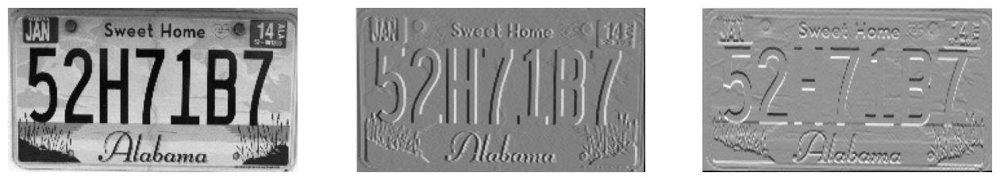

In [21]:
#Horizontal and Vertical Gradients
# Take color intense img first and turn it into grey scale
# And calculate the vertical line and horiizontal lines
image = io.imread("Plates/new/test/ALABAMA/1.jpg")
image = np.uint8(color.rgb2gray(image)*255)
image = np.float32(image)
filt1 = np.array([[0,0,0],[-1,0,1],[0,0,0]])
filt2 = np.matrix.transpose(filt1)

out1 = ndi.correlate(image,filt1,mode='constant')
out2 = ndi.correlate(image,filt2,mode='constant')


fig,(orig,fil1,fil2)= plt.subplots(ncols=3, figsize=(16, 8))

orig.imshow(image,'gray')
orig.axis('off')

fil1.imshow(out1,'gray')
fil1.axis('off')

fil2.imshow(out2,'gray')
fil2.axis('off')

(-0.5, 223.5, 127.5, -0.5)

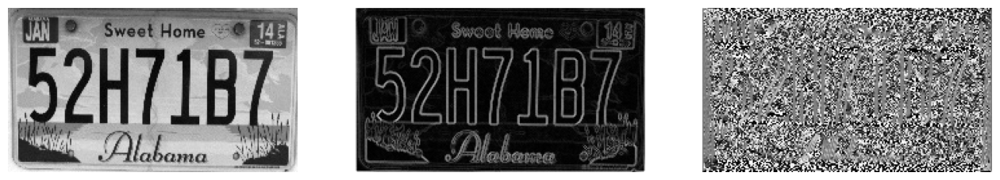

In [22]:
#Here we are finding the magnitude and direction of each gradient 
epsilon = 0.000001
m = np.sqrt(out1**2 + out2**2)
d = np.arctan(out2 / (out1+epsilon))

fig,(orig,magnitude,direction)= plt.subplots(ncols=3, figsize=(16, 8))

orig.imshow(image,'gray')
orig.axis('off')

magnitude.imshow(m,'gray')
magnitude.axis('off')

direction.imshow(d,'gray')
direction.axis('off')

    After looking at the 4 different gradients we can extract from these images it would appear that magnitude will be the best option of the gradients to use for classification. I believe this to be true because it has the most clear edges and color difference that would allow for a combinded feature to help in the classification. 

## Transform plates to magnitude gradients

/var/folders/7x/wsh9sz5x5qddc0q_1ty31n9w0000gn/T/ipykernel_51873/323527325.py:8: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`). Consider using `matplotlib.pyplot.close()`.
  plt.figure()


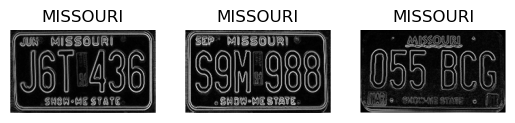

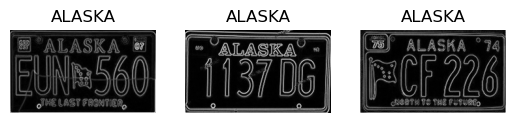

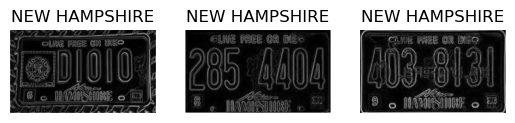

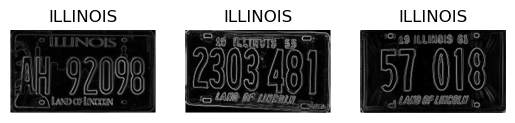

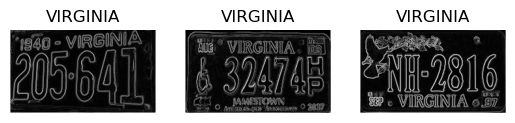

...

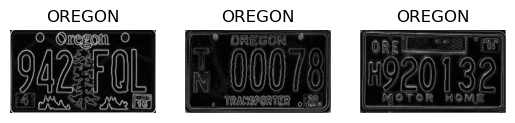

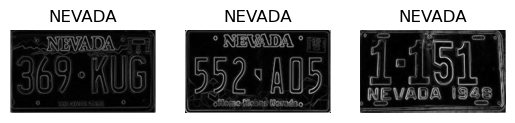

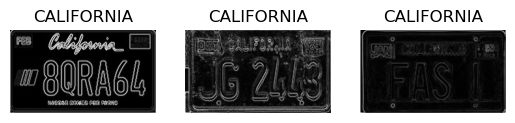

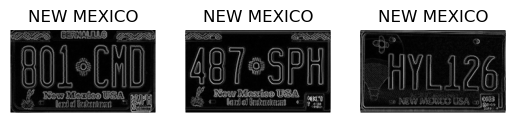

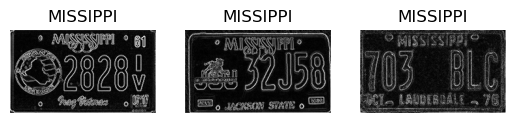

In [23]:
path = "Plates/new/train"

# Get a list of states (directories) within the given path
states = os.listdir(path)
states.remove(".DS_Store")

for state in states:
    plt.figure()
    
    # Iterate over the first 3 images in each state folder
    image_files = os.listdir(os.path.join(path, state))[:3]
    
    for i, file in enumerate(image_files):
        fullpath = os.path.join(path, state, file)
        img = mpimg.imread(fullpath)
        
        # Apply horizontal and vertical gradients
        img_gray = np.uint8(color.rgb2gray(img) * 255)
        img_gray = np.float32(img_gray)
        
        filt1 = np.array([[0, 0, 0], [-1, 0, 1], [0, 0, 0]])
        filt2 = np.transpose(filt1)

        out1 = ndi.correlate(img_gray, filt1, mode='constant')
        out2 = ndi.correlate(img_gray, filt2, mode='constant')

        # Calculate the magnitude of the gradient
        epsilon = 0.000001
        magnitude = np.sqrt(out1**2 + out2**2)

        ax = plt.subplot(1, 3, i + 1)
        ax.set_title(state)
        plt.imshow(magnitude, cmap='gray')
        plt.axis('off')

plt.show()

    After seeing the output of all the state with thier magnitude you can see that there is a property across majority of the plates that we can take advantage of to help with the classification. That propertiy being that the all states have their name printed somewhere on the plate. And the position of the printed name is always located on the top or bottm of the plates. 
    
    So my next solution to classify them more accrurately is to take the magnitude gradient images and crop the images to only have the top third and bottm third of each licsence plate, this way we elimate unnessacry data like plate numbers, logo, flags, state birds etc..

/var/folders/7x/wsh9sz5x5qddc0q_1ty31n9w0000gn/T/ipykernel_51873/965644221.py:3: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`). Consider using `matplotlib.pyplot.close()`.
  plt.figure()


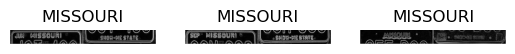

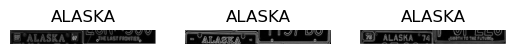

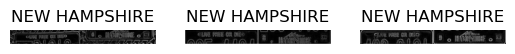

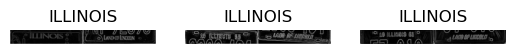

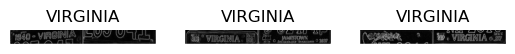

...

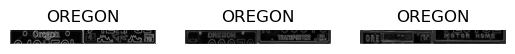

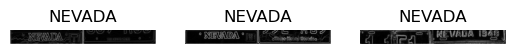

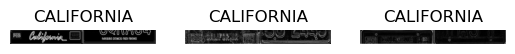

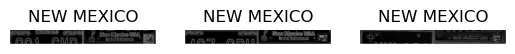

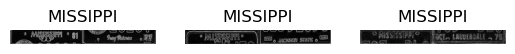

In [24]:
# Takes top and bottom 1/3 of each plate image
for state in states:
    plt.figure()
    
    # Iterate over the first 3 images in each state folder
    image_files = os.listdir(os.path.join(path, state))[:3]
    
    for i, file in enumerate(image_files):
        fullpath = os.path.join(path, state, file)
        img = mpimg.imread(fullpath)
        
        # Apply horizontal and vertical gradients
        img_gray = np.uint8(color.rgb2gray(img) * 255)
        img_gray = np.float32(img_gray)
        
        filt1 = np.array([[0, 0, 0], [-1, 0, 1], [0, 0, 0]])
        filt2 = np.transpose(filt1)

        out1 = ndi.correlate(img_gray, filt1, mode='constant')
        out2 = ndi.correlate(img_gray, filt2, mode='constant')

        # Calculate the magnitude of the gradient
        epsilon = 0.000001
        magnitude = np.sqrt(out1**2 + out2**2)

        # Crop the top 1/3 and bottom 1/3 of the image
        height, width = magnitude.shape
        top_third = magnitude[:height//3, :]
        bottom_third = magnitude[2*height//3:, :]

        # Resize the top third to match the height of the bottom third
        top_third = np.resize(top_third, bottom_third.shape)

        # Concatenate the top and bottom thirds side by side
        concatenated = np.hstack((top_third, bottom_third))

        ax = plt.subplot(1, 3, i + 1)
        ax.set_title(state)
        
        # Display the concatenated image (top 1/3 and bottom 1/3)
        plt.imshow(concatenated, cmap='gray')
        plt.axis('off')

plt.show()

## Magnitude Gradient

    Now with the new images and we must apply the out Supported Machince Learning technique. In this technique I am doing a similiar technique to that of the original images, but since the magnitude gradiante has been apllied to the images the HOG extraction feature should be improved and now that the color histgram is black and white, its basically an edge detection filter. This filter with the magnitude comparable should greately improve the Machine Learning. 

In [ ]:
path = "Plates/new"
dataset = pd.read_csv("Plates/new/plates.csv") 

trainFeatures = []
trainLabels = []

# Feature extraction settings
o = 8
ppc = (32, 32)
cpb = (1, 1)

def compute_hog_features(image, orientations, pixels_per_cell, cells_per_block):
    gray_image = color.rgb2gray(image)  # Convert color image to grayscale
    return feature.hog(gray_image, orientations=orientations, pixels_per_cell=pixels_per_cell, cells_per_block=cells_per_block)

for i in range(len(dataset)):
    if dataset['data set'][i] == 'train':
        image = io.imread(path + '/' + dataset.filepaths[i])
        plateLabel = dataset.labels[i]  # Assuming labels in your CSV contain state information

        # Preprocess the image (resize, etc.)
        image = transform.resize(image, [256, 256])

        # Feature extraction
        fd1 = colorHistogram(image)
        fd2 = compute_hog_features(image, orientations=o, pixels_per_cell=ppc, cells_per_block=cpb)

        # Combine the features
        fd = np.concatenate([fd1, fd2], axis=None)
        trainFeatures.append(fd)
        trainLabels.append(plateLabel)

trainFeatures = np.array(trainFeatures)
trainLabels = np.array(trainLabels)

In [ ]:
# Dimensionality reduction with PCA
s = StandardScaler()
traindata = s.fit_transform(trainFeatures)

# Reduce dimensionality to 50 components (you can adjust this)
pca = PCA(n_components=50, whiten=True)
lowtrain = pca.fit_transform(trainFeatures)

# Train an SVM model
model1 = LinearSVC(penalty='l2', loss='squared_hinge', dual=True, tol=0.1, C=1.0,
                   multi_class='ovr', fit_intercept=True, intercept_scaling=1,
                   class_weight=None, verbose=0, random_state=None, max_iter=10000)

model1.fit(lowtrain, trainLabels)

In [73]:
# Validation set
validFeatures = []
validLabels = []

for i in range(len(dataset)):
    if dataset['data set'][i] == 'valid':
        image = io.imread(path + '/' + dataset.filepaths[i])
        plateLabel = dataset.labels[i]  # Assuming labels in your CSV contain state information

        # Preprocess the image (resize, etc.)
        image = transform.resize(image, [256, 256])

        # Feature extraction
        fd1 = colorHistogram(image)
        fd2 = compute_hog_features(image, orientations=o, pixels_per_cell=ppc, cells_per_block=cpb) # Use multichannel for color images

        # Combine the features
        fd = np.concatenate([fd1, fd2], axis=None)
        validFeatures.append(fd)
        validLabels.append(plateLabel)

validFeatures = np.array(validFeatures)
validLabels = np.array(validLabels)

In [ ]:
# Dimensionality reduction with PCA for validation set
lowvalid = pca.transform(validFeatures)

# Predict labels and calculate accuracy
predictedLabels = model1.predict(lowvalid)
score = model1.score(lowvalid, validLabels)
print("Accuracy =", score)

    Loooking at the results after 10,000 interations and poorly croped images with new gradient filter applied we see a 20% increase in classification accruary. This is good but still can be improved a bit, right now the program is looking over the while image and trying to compare it to the whole images in the dataset but as we saw thier is a lot of cluter so we need to help the machine focus and compare spots or "kernels"  rather then the images in its entirety. 

## 3x3 Kernel

    With the previous results and everything Ivev loearned so far, I believe a way to improve the accraury to to help the program focus by passing a kerel for the computer to focus on. So that the technique I apply here is LBP, Local Binary Patterns, this technique divided the window into cells, then compared each pixel in the cell to each of its neighbors. This techique will compute the histrogram, over the cell, of the frequencet of each number, then concatenate (normalize) histrograms of all cells, giving a feature vector. 

In [31]:
traindata = []
testdata = []
trainlabels = []
testlabels = []
allfiles = []
numtrain = 30
P = 8 
R = 1

for classnum in range(len(states)):
    folder = path + '/train/' + states[classnum]
    filelist = os.listdir(folder)
    for i in range(len(filelist)):
        filename = folder + '/' + filelist[i]
        allfiles.append(filename)
        image = io.imread(filename)
        if len(image.shape) > 2:
            image = color.rgb2gray(image)
        image = transform.resize(image,[256,256])
        fd1 = feature.hog(image, orientations=8, pixels_per_cell=(32, 32), cells_per_block=(1, 1), visualize=False)
        fd = fd1
        if i<numtrain:
            traindata.append(fd)
            trainlabels.append(classnum)
        else:
            testdata.append(fd)
            testlabels.append(classnum)
        if i>100:
            break
        line = '\rProcessing '+ str(i+1) + ' of '+ str(len(filelist)) + ' in class ' + states[classnum] + '              '
        print(line, end='')

traindata = np.array(traindata)
testdata = np.array(testdata)
trainlabels = np.array(trainlabels)
testlabels = np.array(testlabels)
traindata.shape

Processing 101 of 148 in class MISSIPPI                        

(1680, 512)

    After prcressing all our data I want to check and double check if our data is even, clean, and suffient. This next line of code shows the bin size and distributiom of each "label"/state of each image catergory, 

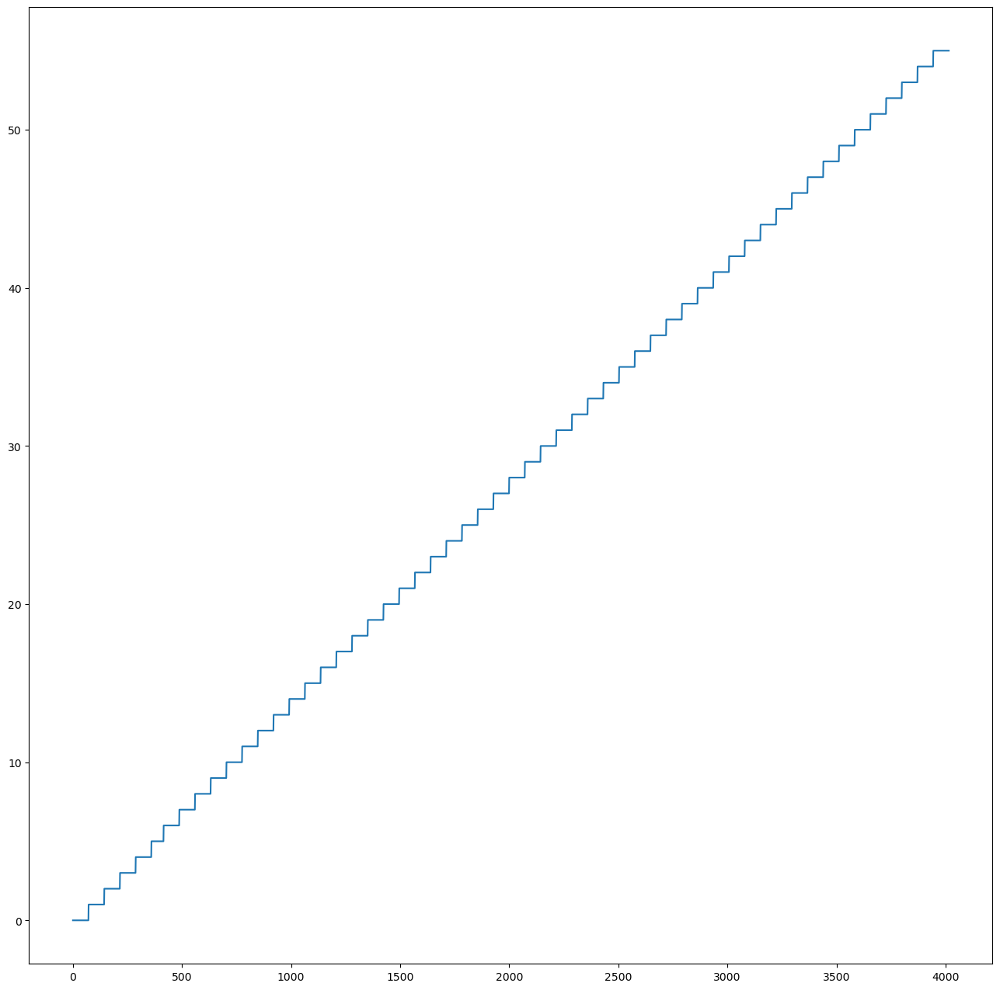

In [32]:
fig = plt.figure(figsize=(16,16))
plt.plot(testlabels)

    Now check the normalized matrix that our training data is suffient and organized to check our classification

<Axes: >

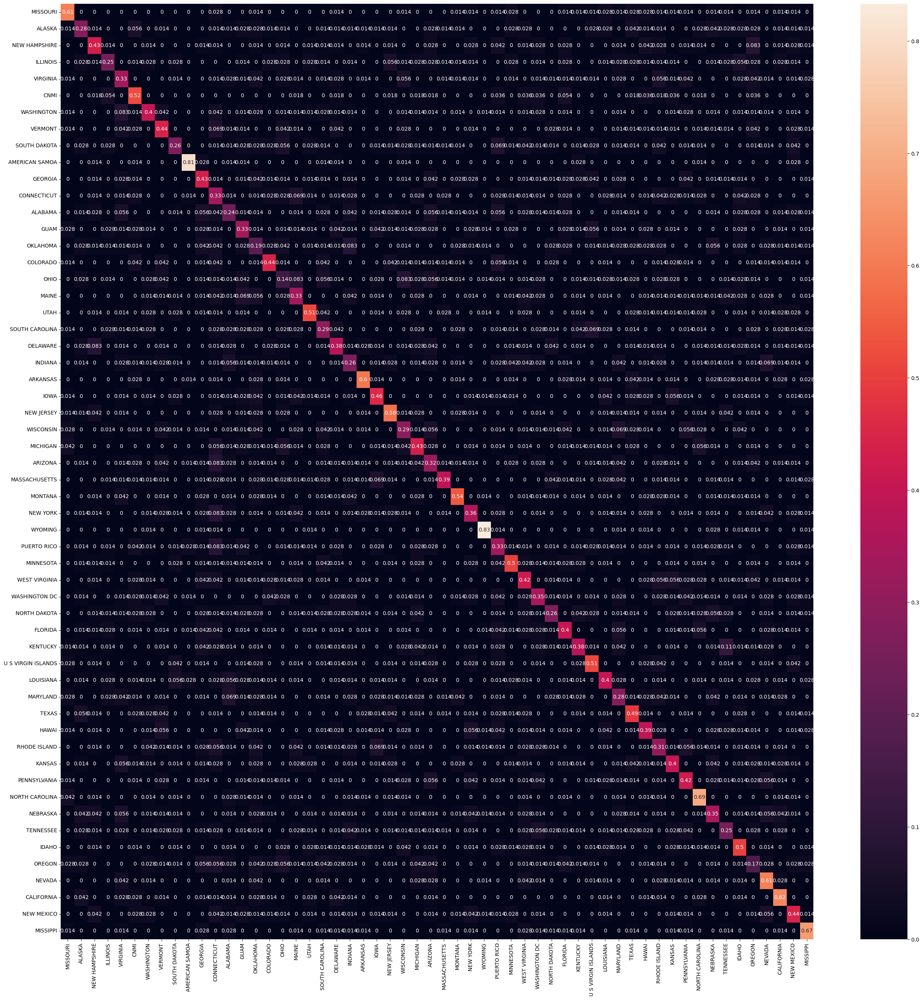

In [63]:
#Visualize performance by Normalized confusion matrix
numClasses = len(states)

conf = np.zeros([numClasses,numClasses])


for digit in range(len(testlabels)):
    real = testlabels[digit]
    guess = predicted_labels[digit]
    conf[real,guess] = conf[real,guess] + 1
 
rowsums = np.sum(conf,1)
rowsums = np.reshape(rowsums,[numClasses,1])
rowsums = np.repeat(rowsums,numClasses, axis = 1)
conf = conf / rowsums
df_cm = pd.DataFrame(conf, index = [i for i in states],
                  columns = [i for i in states])
plt.figure(figsize = (32,32))
sn.heatmap(df_cm, annot=True)

In [64]:
model1 = LinearSVC(penalty='l2', loss='squared_hinge', dual=True, tol=0.0001, 
                   C=1.0, multi_class='ovr', fit_intercept=True, intercept_scaling=1, 
                   class_weight=None, verbose=0, random_state=None, max_iter=10000)
model1.fit(traindata,trainlabels)
predicted_labels = model1.predict(testdata)
# Supoort Vector Class, maximus the distance between two classes 

In [65]:
print('Classification accuracy =',np.average(np.diag(conf)))

Classification accuracy = 0.41376133786848074


    Got the accuracy to increase another 12%!! From the first machine learning where it was 2% to now we can classify at an accuracy of 42%, much improved!
    
# Thank you for listening!